In [1]:
import scanpy, graphtools
import pandas as pd
from collections import OrderedDict
import magic, scipy, scprep
from sklearn import decomposition
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from scipy.spatial.distance import cdist
import pickle

In [2]:
adata_beta = scanpy.read_h5ad('../data/beta_run_2.h5ad')
adata_human_genes = adata_beta.var['human_name']
combined_magic_pc = pd.read_pickle('../data/combined_magic_pc.pkl')

In [3]:
adata_ref = scanpy.read_h5ad('data/local.h5ad')

In [11]:
sample = 'aged'

In [12]:
adata_ref_sample = adata_ref[adata_ref.obs['dataset'] == sample]

In [13]:
intersection_genes = np.array(list(set(adata_beta.var_names).intersection(adata_ref.var_names)))
print('Number of intersection genes', len(intersection_genes))

Number of intersection genes 16337


## scMMGAN

In [14]:
if sample=='db/db':
    sample='db_db'

In [15]:
! ls /home/av622/project/islet_mouse_atlas/output_mouse_normal_to_all_cycle_1_correspondence_15_corr_correspondence*

/home/av622/project/islet_mouse_atlas/output_mouse_normal_to_all_cycle_1_correspondence_15_corr_correspondence_4m_training_counter.npz
/home/av622/project/islet_mouse_atlas/output_mouse_normal_to_all_cycle_1_correspondence_15_corr_correspondence_aged_training_counter.npz
/home/av622/project/islet_mouse_atlas/output_mouse_normal_to_all_cycle_1_correspondence_15_corr_correspondence_db_db_training_counter.npz


In [16]:
out = np.load(f'/home/av622/project/islet_mouse_atlas/output_mouse_normal_to_all_cycle_1_correspondence_15_corr_correspondence_{sample}_training_counter.npz')
ctrl_magan = pd.DataFrame(out['sample_to_all'], index=adata_ref_sample.obs_names, columns=adata_beta.var_names)

In [17]:
X = ctrl_magan[intersection_genes] - ctrl_magan[intersection_genes].mean(axis=0) + adata_beta.to_df()[intersection_genes].mean(axis=0)

In [18]:
for gene in intersection_genes:
    ctrl_magan[gene] = X[gene]

In [19]:
ctrl_magan.columns = adata_human_genes

In [20]:
ctrl_magan_magic_pc = pd.DataFrame(out['sample_to_all_pc'], index=adata_ref_sample.obs_names)
ctrl_magan_magic_pc_norm = ctrl_magan_magic_pc / np.std(out['sample_to_all_pc'][:, 0])

In [21]:
fig = plt.figure()
ax = fig.add_subplot(projection='3d')
scprep.plot.scatter3d(combined_magic_pc, ax=ax, c='lightgray', ticks=True, alpha=0.1, azim=-150)
scprep.plot.rotate_scatter3d(ctrl_magan_magic_pc, ax=ax, ticks=True, azim=-150)

In [22]:
with open('../data/combined_magic_pc_op.pkl', 'rb') as f:
    combined_pc_op = pickle.load(f)

In [23]:
ctrl_magan_magic_pc_mapped = pd.DataFrame(combined_pc_op.transform(ctrl_magan), index=adata_ref_sample.obs_names)
ctrl_magan_magic_pc_mapped_norm = ctrl_magan_magic_pc_mapped / np.std(ctrl_magan_magic_pc_mapped.iloc[:, 0])

In [24]:
fig = plt.figure()
ax = fig.add_subplot(projection='3d')
scprep.plot.scatter3d(combined_magic_pc, ax=ax, c='lightgray', ticks=True, alpha=0.1, azim=-150)
scprep.plot.rotate_scatter3d(ctrl_magan_magic_pc_mapped, ax=ax, ticks=True, azim=-150)

## AAnet

In [25]:
adata_beta_wt = adata_beta[adata_beta.obs['samples'] == 'WT']
adata_beta_hfd = adata_beta[adata_beta.obs['samples'] == 'HFD']
adata_beta_obob = adata_beta[adata_beta.obs['samples'] == 'OB/OB']

In [26]:
wt_latent = np.load('../analysis_archetypes/results/WT_latent_coords_7_ats.npy')
at_dist = []
for row in wt_latent:
    id = np.argwhere(row > 0.5)
    if len(id) == 1:
        at_dist.append('WT AT ' + str(id[0][0]+1))
        
    else:
        at_dist.append('Uncommitted')
        
wt_at_comms = pd.Series(at_dist, index = adata_beta_wt.obs_names)

In [27]:
wt_latent = np.load('../analysis_archetypes/results/HFD_latent_coords_4_ats.npy')
at_dist = []
for row in wt_latent:
    id = np.argwhere(row > 0.5)
    if len(id) == 1:
        at_dist.append('HFD AT ' + str(id[0][0]+1))
        
    else:
        at_dist.append('Uncommitted')
        
hfd_at_comms = pd.Series(at_dist, index = adata_beta_hfd.obs_names)

In [28]:
wt_latent = np.load('../analysis_archetypes/results/OB_OB_latent_coords_3_ats.npy')
at_dist = []
for row in wt_latent:
    id = np.argwhere(row > 0.5)
    if len(id) == 1:
        at_dist.append('OB/OB AT ' + str(id[0][0]+1))
        
    else:
        at_dist.append('Uncommitted')
        
obob_at_comms = pd.Series(at_dist, index = adata_beta_obob.obs_names)

In [29]:
at_comms = pd.concat((wt_at_comms, hfd_at_comms, obob_at_comms)).loc[adata_beta.obs_names]

## Get closest human 

In [30]:
dist = cdist(ctrl_magan_magic_pc_mapped, combined_magic_pc)
nearest_10_cells = adata_beta.obs_names[np.argsort(dist, axis=1)[:, :1].flatten()]

In [31]:
human_at_comms = at_comms.loc[nearest_10_cells]

In [32]:
df = pd.concat(((100 * human_at_comms.value_counts() / human_at_comms.value_counts().sum()), 
100 * at_comms.value_counts() / at_comms.value_counts().sum()), axis=1)
df.columns = [sample, 'PDAC model']

In [33]:
df = df[['PDAC model', sample]]

In [34]:
df.to_csv(f'results/{sample}_at_proportions.csv')

In [35]:
df = df.loc[sorted(df.index)]

In [36]:
colors = list(sns.color_palette('Set1', n_colors=4)) + \
list(sns.color_palette('Paired', n_colors=3)) + ['lightgray'] + \
list(sns.color_palette('Set2', n_colors=7).as_hex())

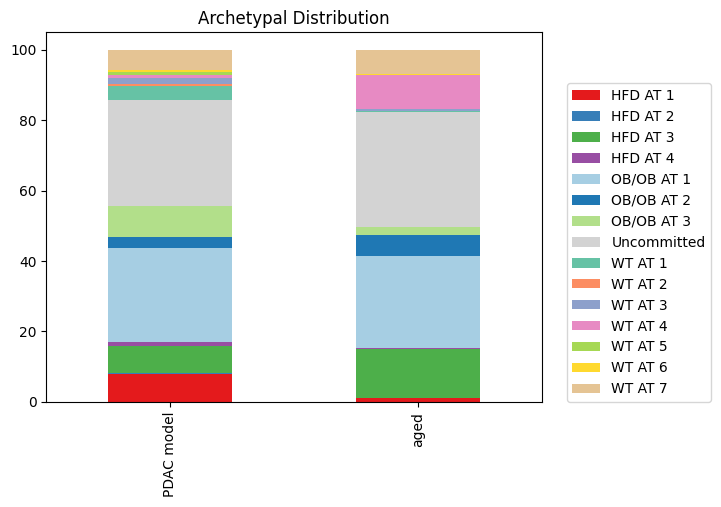

In [37]:
df.T.plot.bar(stacked=True, color=colors)
plt.title('Archetypal Distribution')
plt.legend(loc=(1.05,0))

In [39]:
scprep.plot.rotate_scatter3d(ctrl_magan_magic_pc_mapped, c=human_at_comms, cmap=colors, ticks=None, legend_loc=(1.05,0), azim=-150)

In [ ]:
scprep.plot.scatter3d(ctrl_magan_magic_pc_mapped, c=human_at_comms, cmap=colors, ticks=None, legend_loc=(1.05,0), azim=-150)